# Proximal Denoising

In [1]:
import numpy as np
import matplotlib.pyplot as plt
import pywt

In [2]:
img = plt.imread("florence.jpg").astype("int") #[:,:,0]

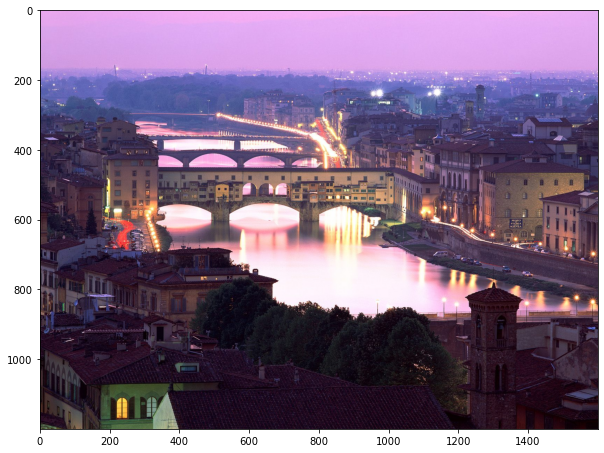

In [3]:
fig = plt.figure(figsize=(10, 8))
plt.imshow(img)
plt.show()

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


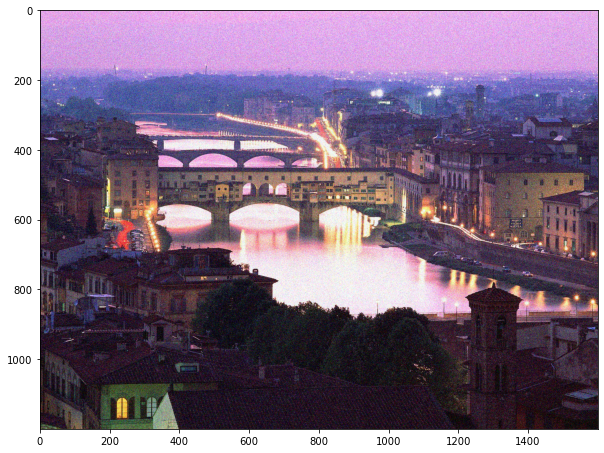

In [68]:
fig = plt.figure(figsize=(10, 8))
gaussian_noise = np.random.normal(0, 30, size=np.shape(img))/256
y = img/256 + gaussian_noise
plt.imshow(y)
plt.show()

In [69]:
def proximal(x, q=2, chi = 10):
    if q==1 : 
        return np.sign(x)*np.maximum(x, 0)
    if q==4/3 :
        eps = np.sqrt(x**2+256*chi**3/729)

        return x + q*chi/(2**(1/3)) * ((eps-x)**(1/3) - (eps + x)**(1/3))
    if q==2 :
        return x/(1+2*chi)
    
    if q==3 : 
        return np.sign(x)*(np.sqrt(1+12*chi*np.abs(x))-1)/(6*chi)
    
    if q==4 : 
        eps = np.sqrt(x**2 + 1/(27*chi))
        return (((eps-x)/(8*chi))**(1/3) - ((eps+x)/(8*chi))**(1/3))

In [70]:
chi = 10
q = 2

In [71]:
def denoising(img, chi=10, q=4, level=1) :
    denoised_img = np.zeros(img.shape)
    for c in [0, 1, 2] :
        coeffs = pywt.wavedec2(img[:,:,c], "bior1.1", level=level)
        new_coeffs = [coeffs[0]]
        for i in range(1,level+1) :
            cH, cV, cD = proximal(coeffs[i][0], q=q, chi=chi), proximal(coeffs[i][1], q=q, chi=chi), proximal(coeffs[i][2], q=q, chi=chi)
            new_coeffs.append((cH, cV, cD))
        denoised_img[:,:,c] = pywt.waverec2(new_coeffs, "bior1.1")

    return denoised_img

In [74]:
a = denoising(y, level=1)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


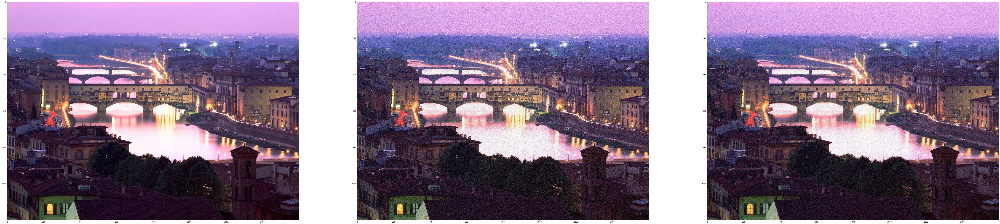

In [75]:
fig, ax = plt.subplots(1, 3, figsize=(100, 100))
ax[0].imshow(img)
ax[1].imshow(y)
ax[2].imshow(a)
plt.show()
